In [1]:
import torch
torch.set_num_threads(1)
from pprint import pprint
import torchaudio
import IPython.display as ipd
import numpy as np

import matplotlib.pyplot as plt

In [2]:
model, utils = torch.hub.load(repo_or_dir='snakers4/silero-vad',
                              model='silero_vad',
                              force_reload=True)

(get_speech_ts,
 get_speech_ts_adaptive,
 _, read_audio,
 _, _, _) = utils


Downloading: "https://github.com/snakers4/silero-vad/archive/master.zip" to /home/arseny/.cache/torch/hub/master.zip


In [3]:
song_pth = "../data/samples/Arctic Monkeys-MadSounds.wav"

In [4]:
wav, sr = torchaudio.load(song_pth)

In [5]:
wav = wav.mean(dim=0, keepdim=False)

In [6]:

transform = torchaudio.transforms.Resample(orig_freq=sr,
                                           new_freq=16000)
wav = transform(wav)
sr = 16000

/home/arseny/.local/share/virtualenvs/music-ai-trainer-TlEmgf2U/lib/python3.8/site-packages/torch/nn/modules/module.py:1051: UserWarning: stft will soon require the return_complex parameter be given for real inputs, and will further require that return_complex=True in a future PyTorch release. (Triggered internally at  /pytorch/aten/src/ATen/native/SpectralOps.cpp:664.)
  return forward_call(*input, **kwargs)


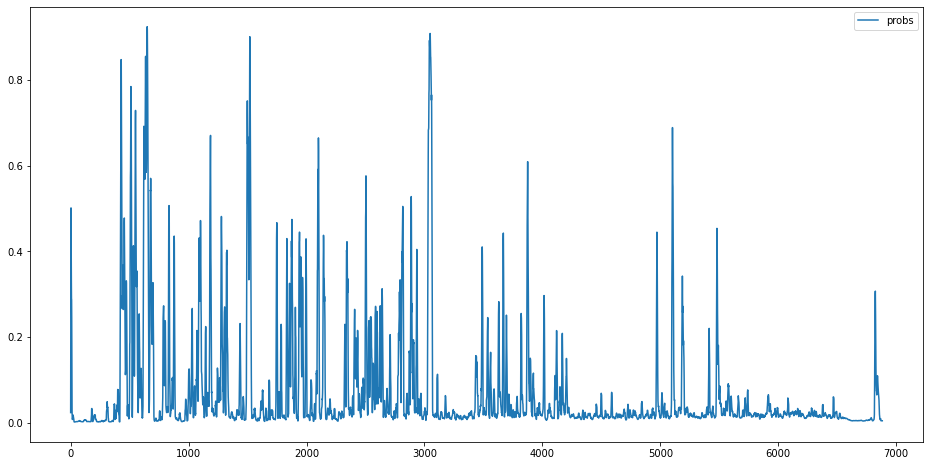

In [7]:
# files_dir = torch.hub.get_dir() + '/snakers4_silero-vad_master/files'

# wav = read_audio(f'{files_dir}/en.wav')
# full audio
# get speech timestamps from full audio file

# classic way
speech_timestamps = get_speech_ts(wav, model, trig_sum=0.03,
                                  visualize_probs=True)

In [8]:
len(speech_timestamps)

66

In [9]:
import librosa
has_voice_tone = librosa.tone(frequency=200, sr=sr, length=len(wav))

In [10]:
has_voice_mask = np.full(len(wav), False)

In [11]:
for period in speech_timestamps:
    has_voice_mask[period["start"]: period["end"]] = True

In [12]:
has_voice_tone[~ has_voice_mask] = 0
ipd.Audio(has_voice_tone, rate=sr)

In [13]:
ipd.Audio(has_voice_tone + wav.numpy(), rate=sr)

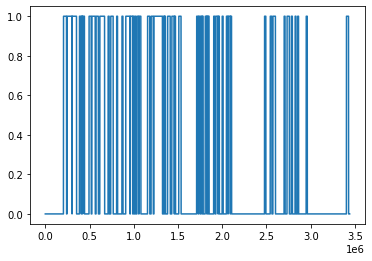

In [14]:
plt.plot(has_voice_mask)

In [15]:
winsize = 16000 * 4
rolling_mean_has_voice = np.convolve(has_voice_mask, np.ones(winsize), 'same') / winsize

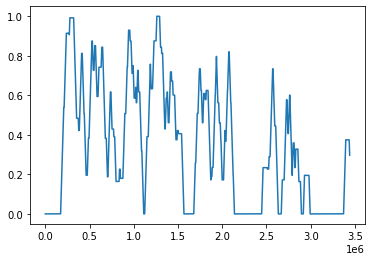

In [16]:
plt.plot(rolling_mean_has_voice)

In [17]:
len(has_voice_tone), len(rolling_mean_has_voice)

(3441025, 3441025)

In [18]:
import librosa
has_voice_tone = librosa.tone(frequency=200, sr=sr, length=len(wav))

has_voice_tone[rolling_mean_has_voice < 0.05] = 0
ipd.Audio(has_voice_tone + wav.numpy(), rate=sr)

In [20]:
probs = get_voicing_probs(model, wav)

In [21]:
probs.sum(axis=1)

tensor([1.0001, 0.9979, 1.0015,  ..., 1.0000, 1.0000, 1.0000])

In [22]:
len(wav) / len(probs)

506.03308823529414

In [23]:
wav_prob = np.full(len(wav), np.nan)

step = len(wav) / len(probs)
start = 0

for prob in probs:
    wav_prob[round(start): round(start + step)] = prob[1]
    start += step

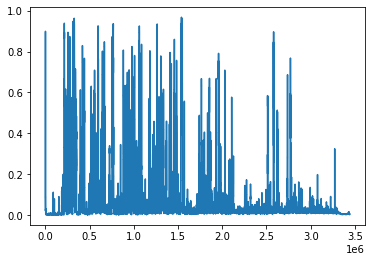

In [24]:
plt.plot(wav_prob)

In [28]:
winsize = 16000
rolling_mean_wav_prob = np.convolve(wav_prob, np.ones(winsize), 'same') / winsize

In [29]:
has_voice_tone = librosa.tone(frequency=200, sr=sr, length=len(wav))

has_voice_tone[rolling_mean_wav_prob < 0.02] = 0
ipd.Audio(has_voice_tone + wav.numpy(), rate=sr)

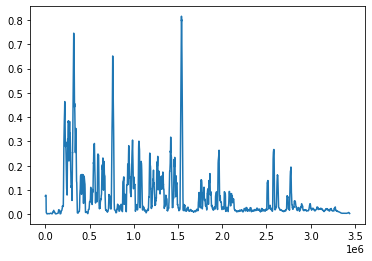

In [30]:
plt.plot(rolling_mean_wav_prob)

In [32]:
import torchaudio

import torch.nn.functional as F

def get_voicing_probs(model, wav, num_samples_per_window: int = 4000, num_steps: int = 8, batch_size=200, thresh=0.02):
    
    num_samples = num_samples_per_window
    assert num_samples % num_steps == 0
    step = int(num_samples / num_steps)  # stride / hop
    
    outs = []
    to_concat = []
    for i in range(0, len(wav), step):
        chunk = wav[i: i+num_samples]
        if len(chunk) < num_samples:
            chunk = F.pad(chunk, (0, num_samples - len(chunk)))
        to_concat.append(chunk.unsqueeze(0))
        if len(to_concat) >= batch_size:
            chunks = torch.Tensor(torch.cat(to_concat, dim=0))
            with torch.no_grad():
                out = model(chunks)
            outs.append(out)
            to_concat = []

    outs = torch.cat(outs, dim=0)
    return outs[:, 1] # 1 dim is 'neg' and 'pos' classes, so take pos probability

def get_voice_activity_mask(wav, model, sr, ):
    
    transform = torchaudio.transforms.Resample(orig_freq=sr,
                                               new_freq=16000)
    wav = transform(wav)
    sr = 16000
    
    probs = get_voicing_probs(model, wav)
    
    wav_prob = np.full(len(wav), 0)

    step = len(wav) / len(probs)
    start = 0

    for prob in probs:
        wav_prob[round(start): round(start + step)] = prob
        start += step
    
    winsize = 16000
    rolling_mean_wav_prob = np.convolve(wav_prob, np.ones(winsize), 'same') / winsize
    
    return rolling_mean_wav_prob >= thresh